# Data Science Case Study: Candidate Resume Search Platform

## Business Context & Objective

### Background
You are joining the Business Development team at Millennium which is a global hedge fund that manages assets across multiple investment strategies (fundamental equity, systematic trading, credit, etc.). The BD team is responsible for sourcing junior analyst talent across different:

- **Geographic Markets**: US, Europe, Asia-Pacific
- **Investment Approaches**: Fundamental vs. Systematic/Quantitative strategies
- **Sectors**: Technology, Healthcare, Financial Services, Energy, Industrials, Consumer, Credit, Macro, etc.
- **Experience Levels**: depending on the job requisitions

### Goal
Build a **searchable platform** to quickly identify candidates based on specific criteria based on job requisitions.

### Your Task
1. Parse resume data from PDF/Word documents using **LLM models via API**
2. Create parsed resume data as **JSON, CSV, etc.** for further analysis
3. Create a **Streamlit web application** where BD users can search and filter candidates using multiple criteria
   (Based on the background provided above, you will come up with relevant filters)
4. Visualize candidate distributions and insights
5. **Design for scalability** to handle large volumes of resumes

### Output
1. Code for data parsing and Streamlit in **this Jupyter notebook** for ease of review
2. Include the **link to Streamlit app** in the notebook
3. **JSON/CSV exports** of parsed resume data
4. Discussion of additional features and implementation approach if more time was available
---

## Sample Resume Data

**You have access to 10 made up resume files representing different candidate profiles**

---

## Technical Requirements & Evaluation
  
### Evaluation Criteria
1. **Technical Implementation (40%)**: Code quality, data processing, performance
2. **User Experience (30%)**: Interface design, functionality, responsiveness
3. **Business Value (20%)**: Feature completeness, search capabilities, insights
4. **Documentation (10%)**: Code comments, README, presentation

### Time Recommendation
- **Total Estimated Time**: ~9 hours (**tight but achievable with focused approach**)
- **Recommended Strategy**: Build core MVP in 6-7 hours, then enhance

### Phased Approach (Recommended)
**Phase 1 (3 hours): Core Parsing & Data**
- Set up LLM API integration (OpenAI, Anthropic, or alternatives)
- Parse 2-3 sample resumes using LLM
- Create structured data format with JSON, etc.
- Build basic data validation and quality checks
 
**Phase 2 (3 hours): Streamlit**  
- Basic filter interface
- Simple results display
- Core visualizations

**Phase 3 (2-3 hours): Enhancement**
- Parse remaining resumes
- Add advanced filters
- Polish UI/UX

### Success Criteria (MVP)
- LLM-powered parsing of at least 5-7 resume files with high accuracy
- Working Streamlit app with basic search functionality
- At least 3-4 meaningful filters working
- A few visualizations showing candidate insights
- JSON/CSV output of parsed resume data
- Clean, documented code


---

## Setup & Imports

Import all necessary libraries and modules for document processing, validation, chunking, and extraction.

In [18]:
# Standard library imports
import os
import json
from pathlib import Path
from typing import List, Dict, Any
import pandas as pd

# Visualization imports
from IPython.display import display, Image as DisplayImage, Markdown, HTML
from PIL import Image as PILImage

# Project imports
from config import get_config
from document_validator import DocumentValidator
from vision_document_loader import VisionDocumentLoader
from resume_parser_langchain import (
    ResumeParser, 
    TextSplitter,
    export_to_json, 
    export_to_csv
)

# Initialize configuration
config = get_config()
parser_cfg = config.get_parser_config()
input_folder = Path(parser_cfg.input_folder)
resume_files = sorted(input_folder.glob("*"))

---

## 1. Document Visualization

Display all documents in the input folder to preview the resume files before processing.


Found 10 document(s) to display:


Displaying: Chen Li (Alex).docx


--- Page 1 of 2 ---



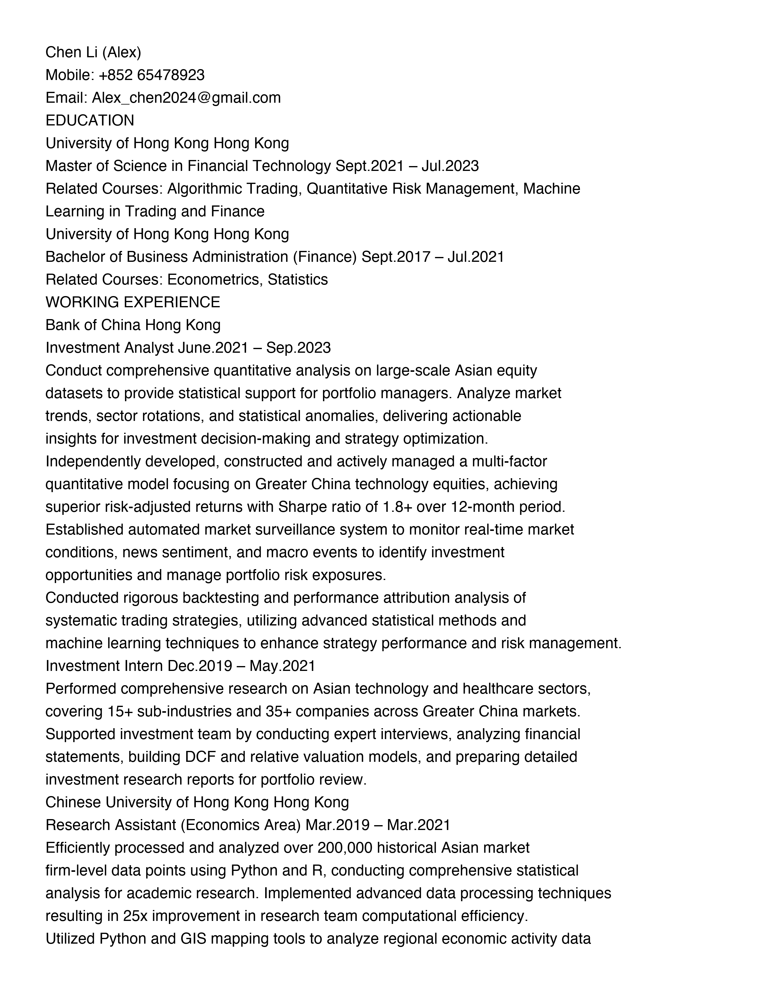


--- Page 2 of 2 ---



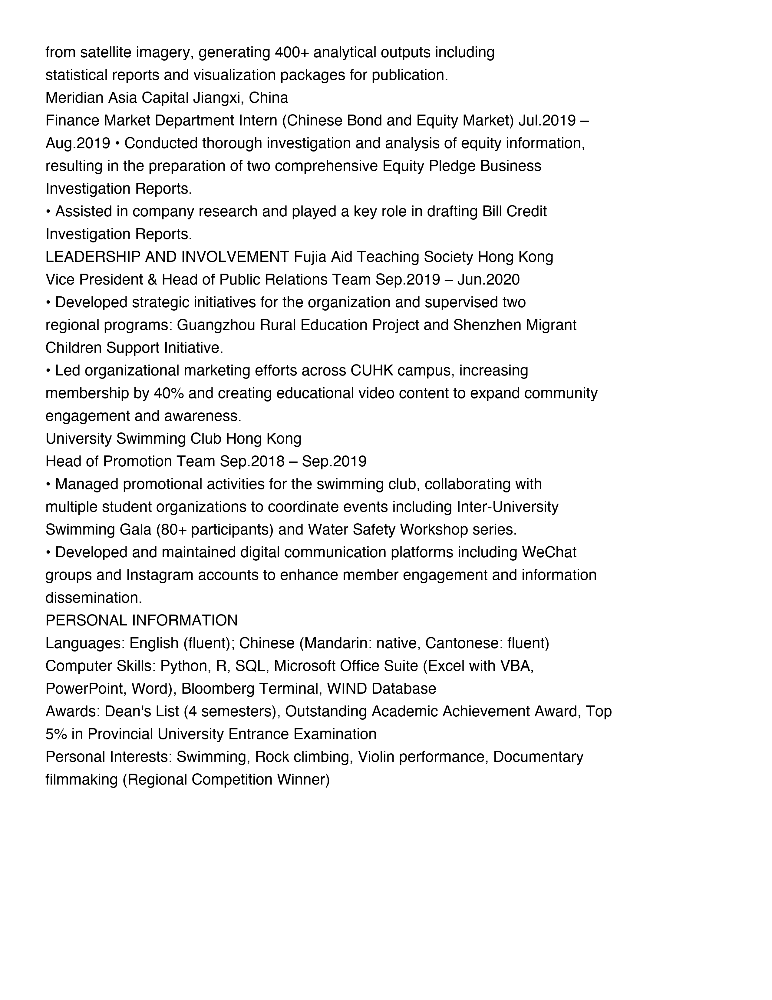




Displaying: MARINA SILVA COSTA.docx


--- Page 1 of 2 ---



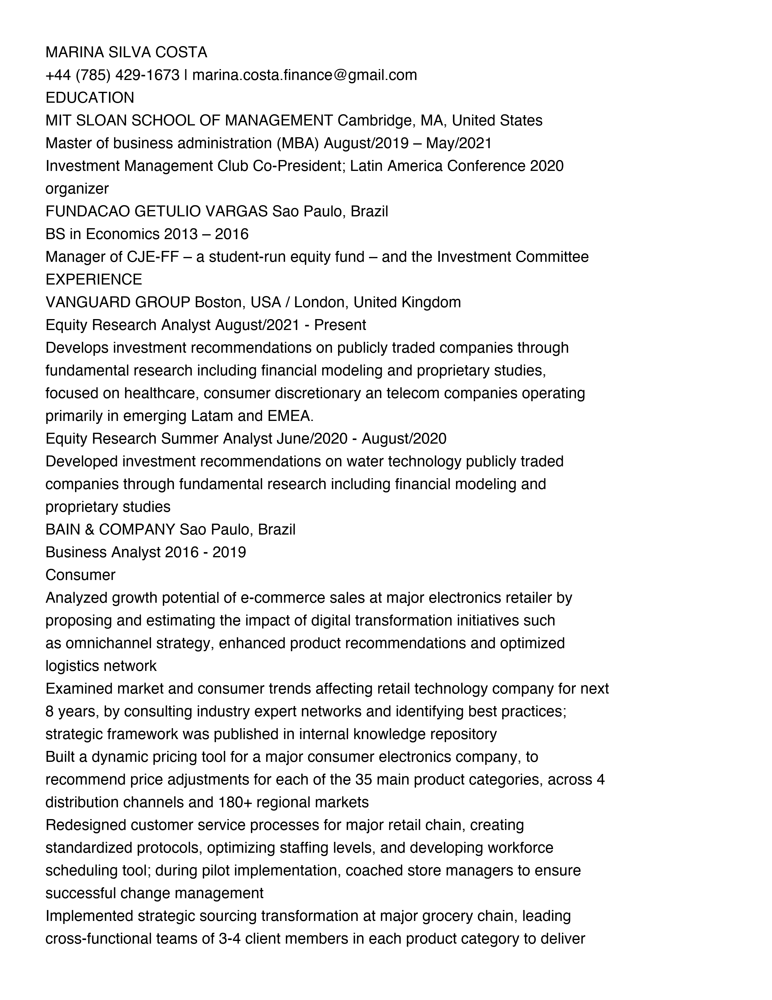


--- Page 2 of 2 ---



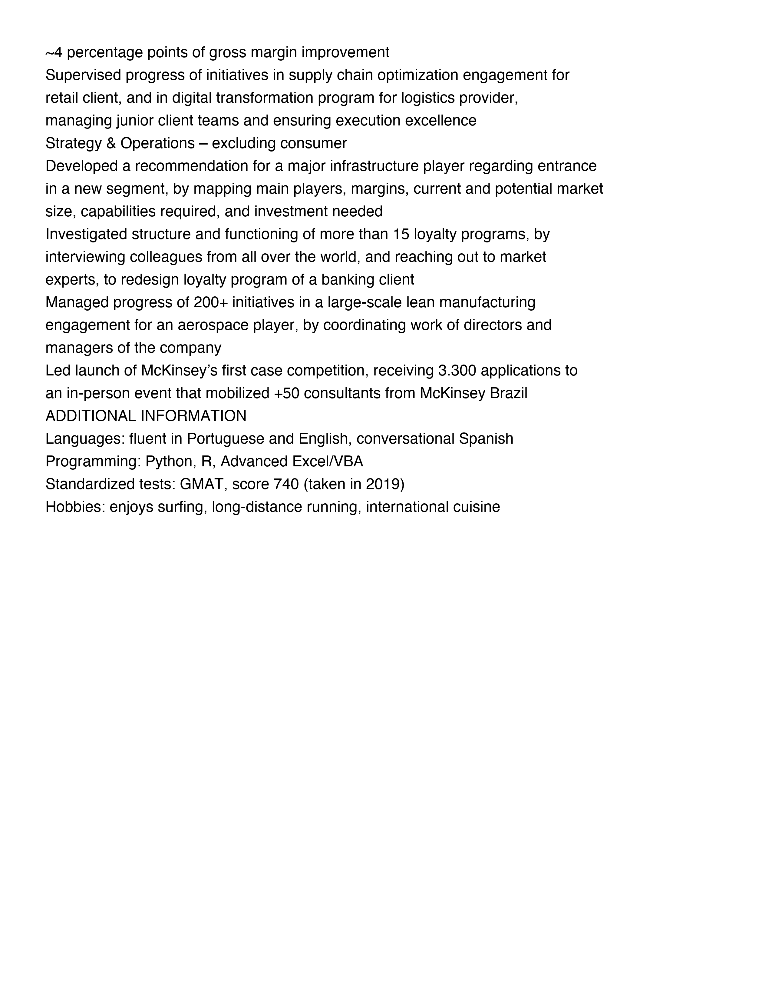




Displaying: Marcus Chen-Rodriguez Resume.docx


--- Page 1 of 2 ---



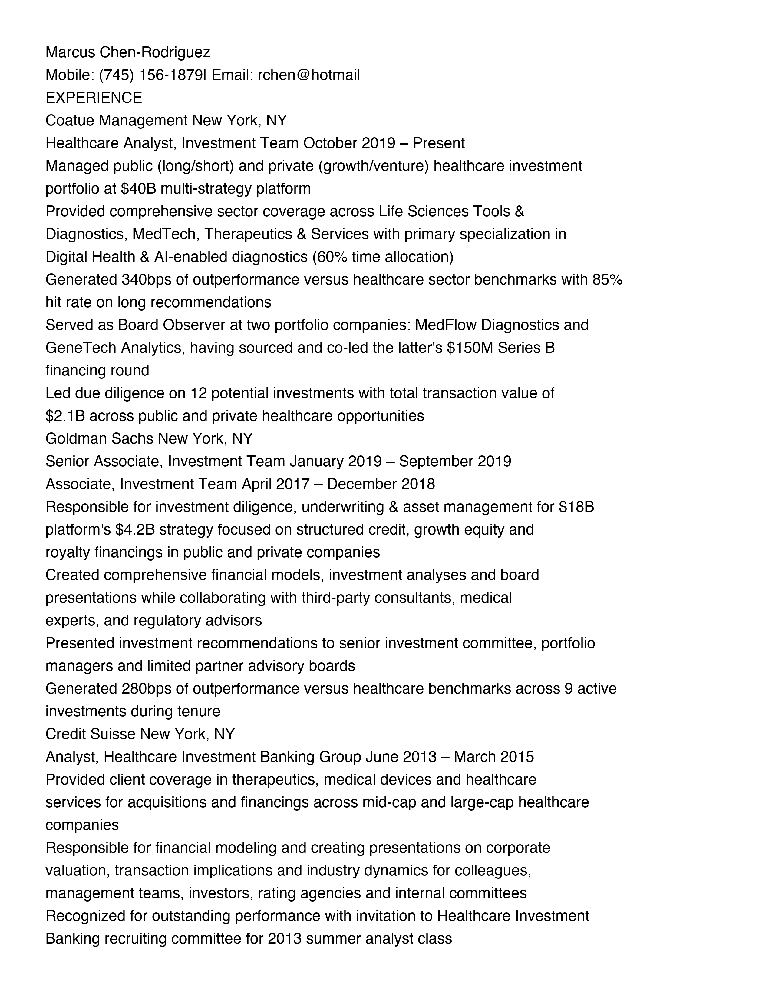


--- Page 2 of 2 ---



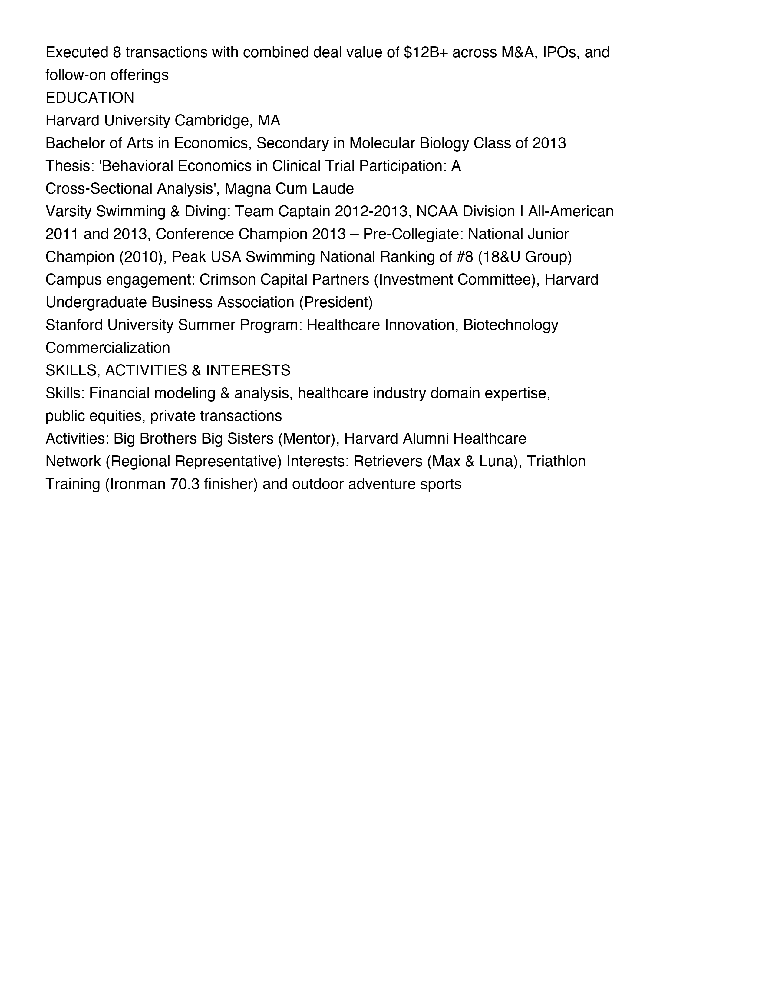




Displaying: Michael Rodriguez, CFA.docx


--- Page 1 of 2 ---



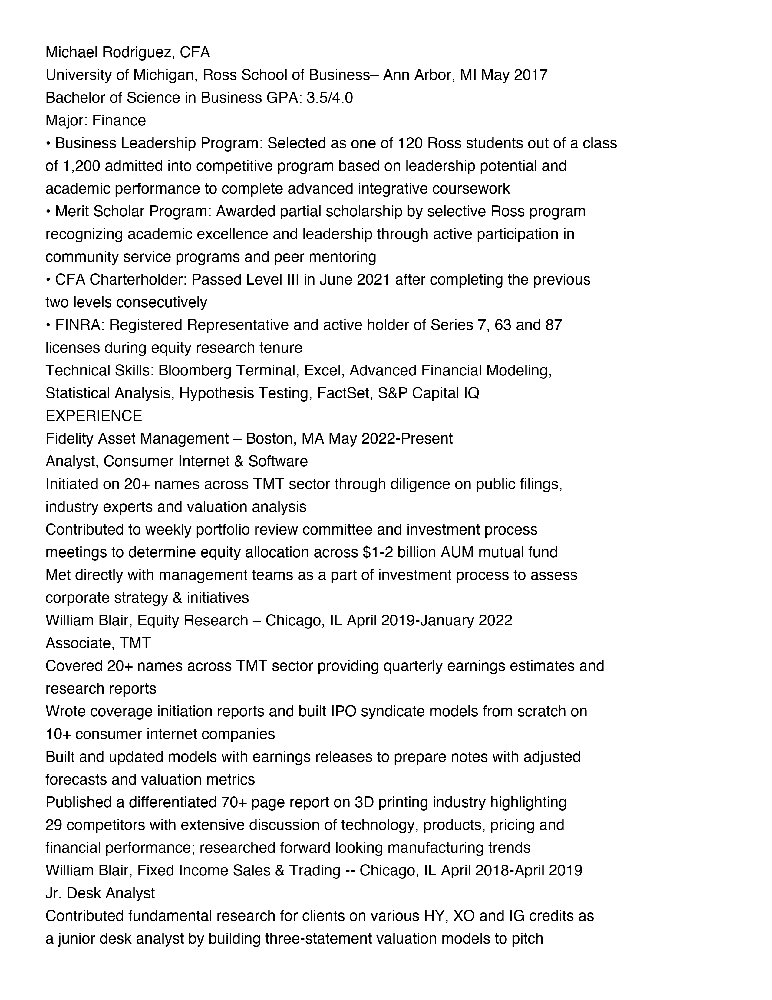


--- Page 2 of 2 ---



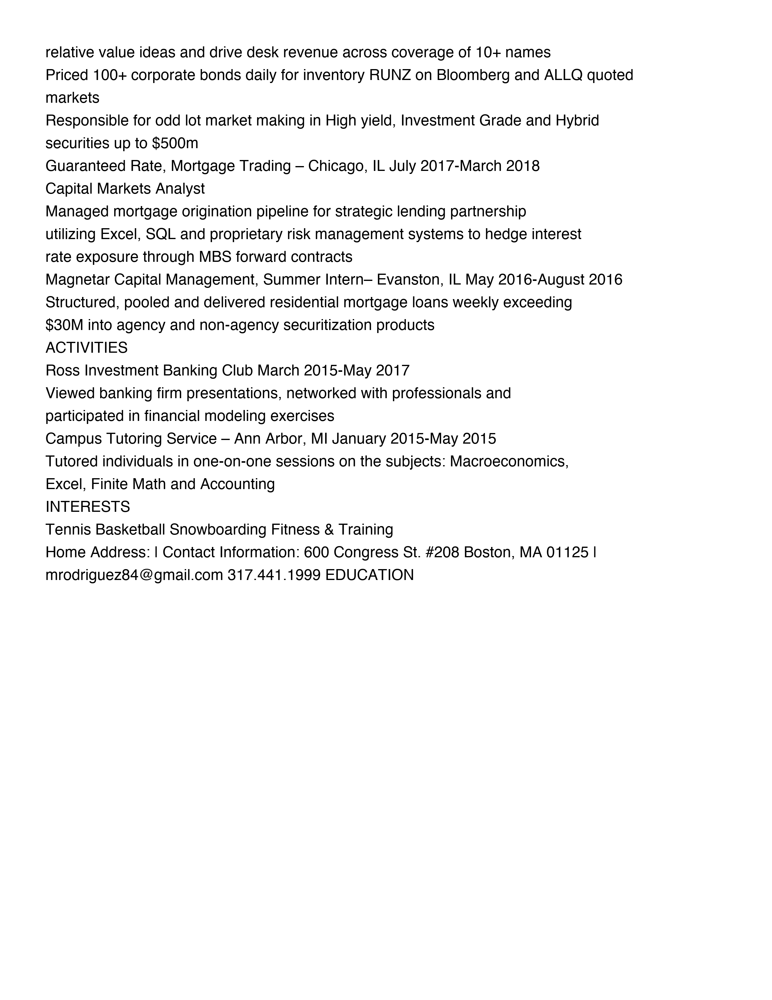




Displaying: Omar El-Hassan 202405.pdf


--- Page 1 of 1 ---



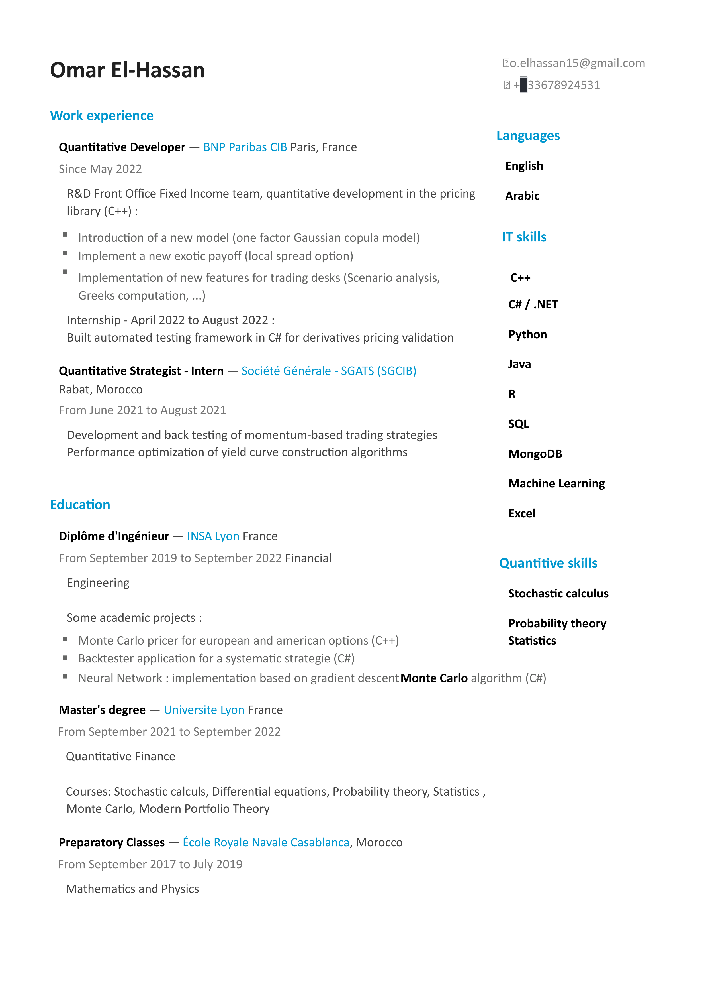




Displaying: Priya Nakamura_sellside_healthcare_RLTM.docx


--- Page 1 of 3 ---



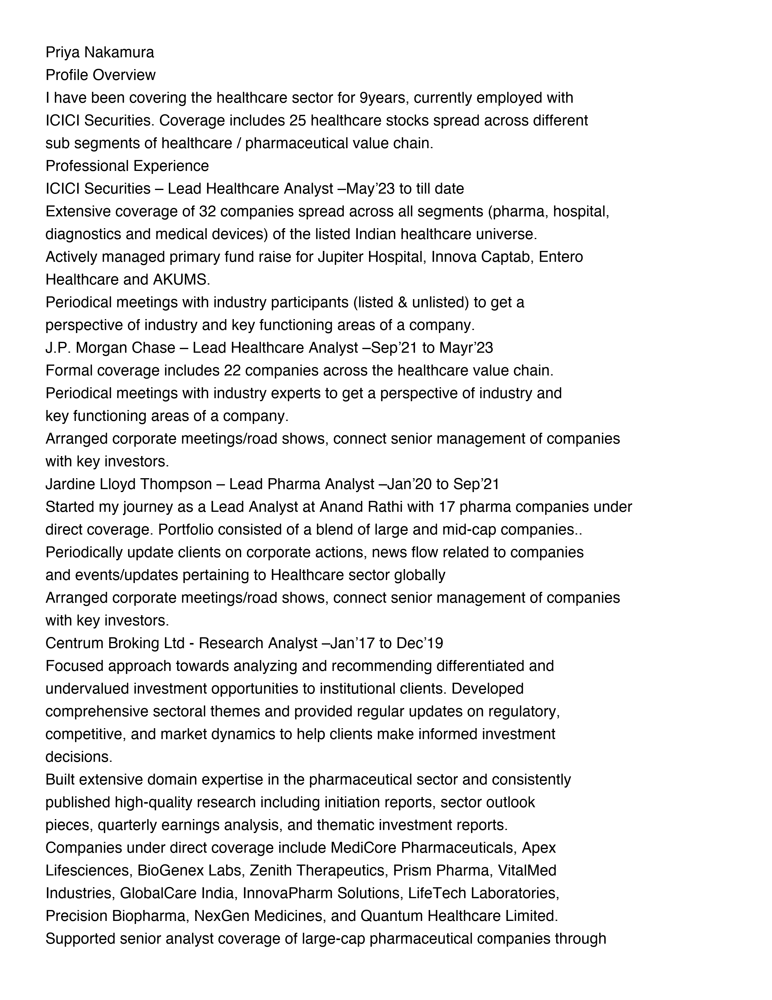


--- Page 2 of 3 ---



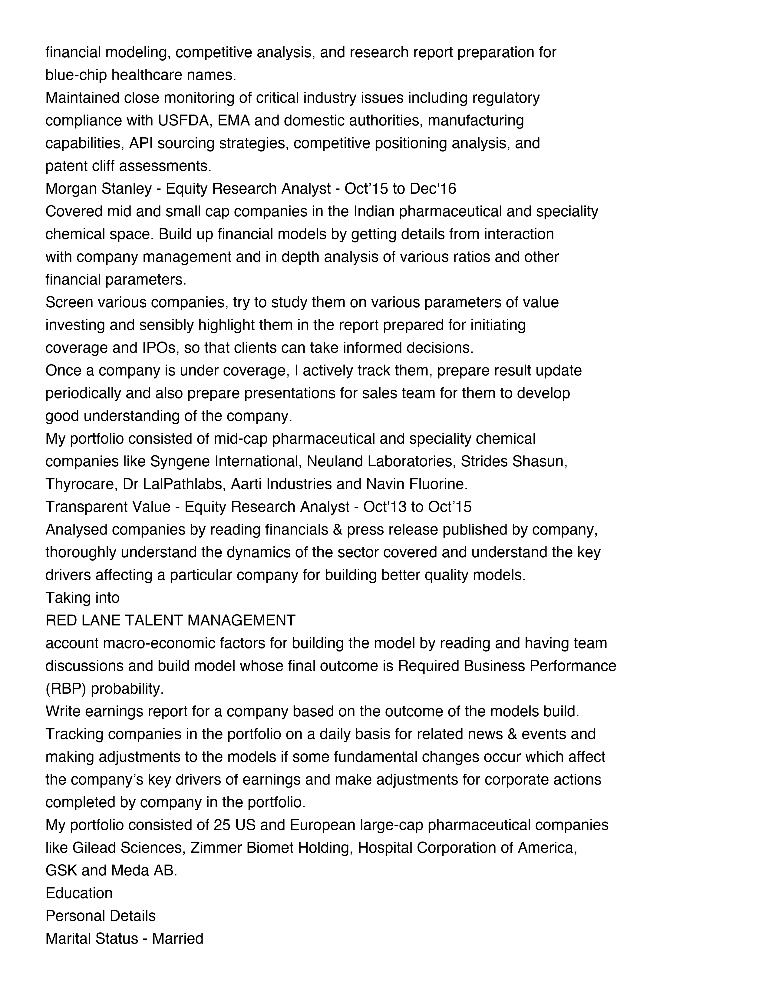


--- Page 3 of 3 ---



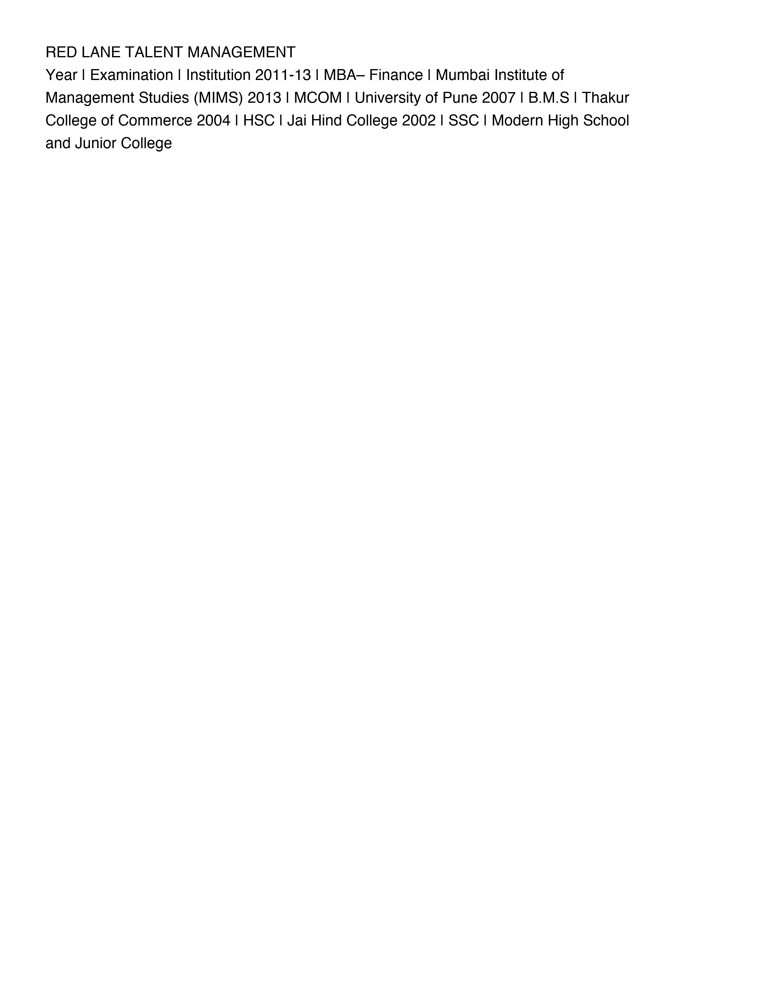




Displaying: RYAN PATEL - Resume.pdf


--- Page 1 of 2 ---



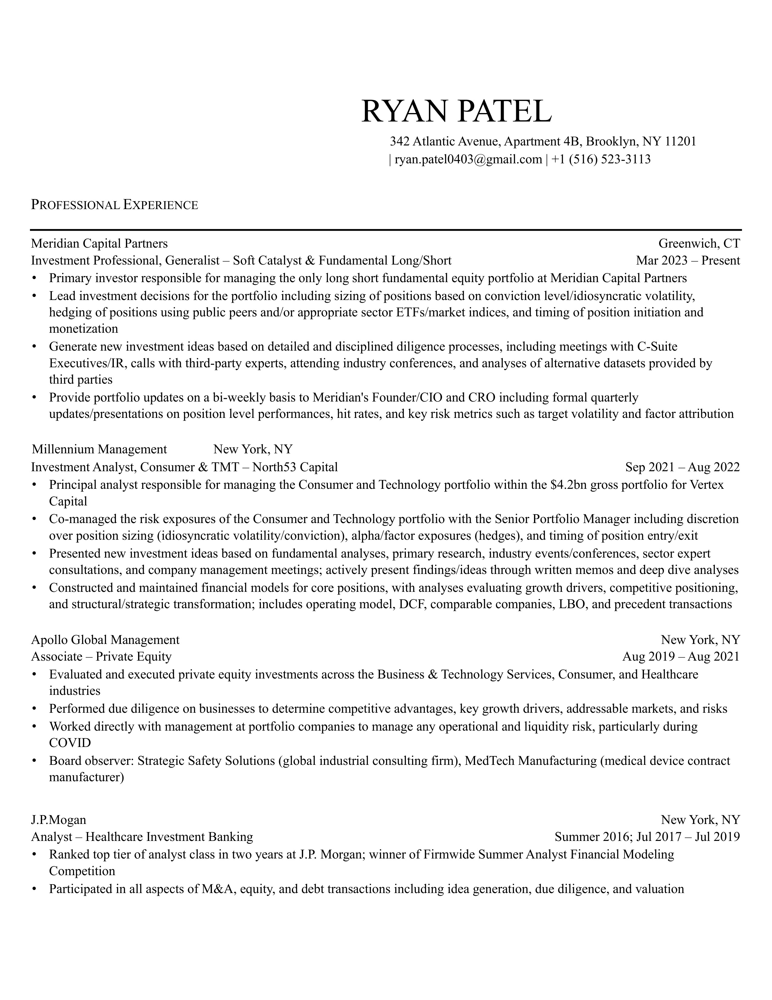


--- Page 2 of 2 ---



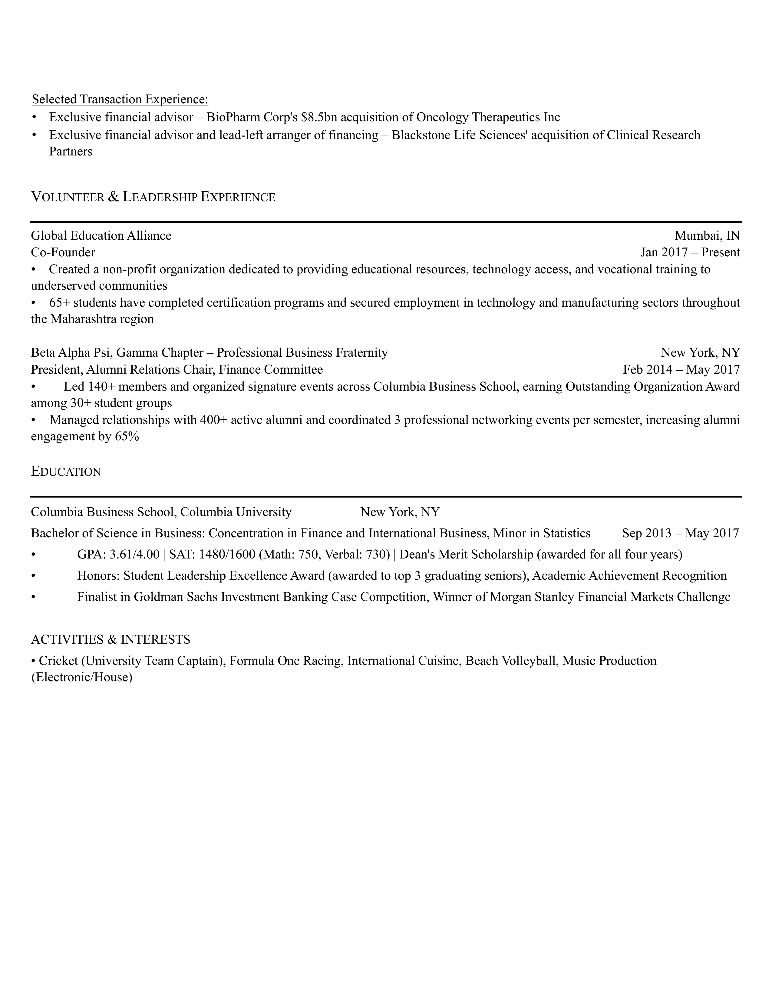




Displaying: Vikram Shah.docx


--- Page 1 of 2 ---



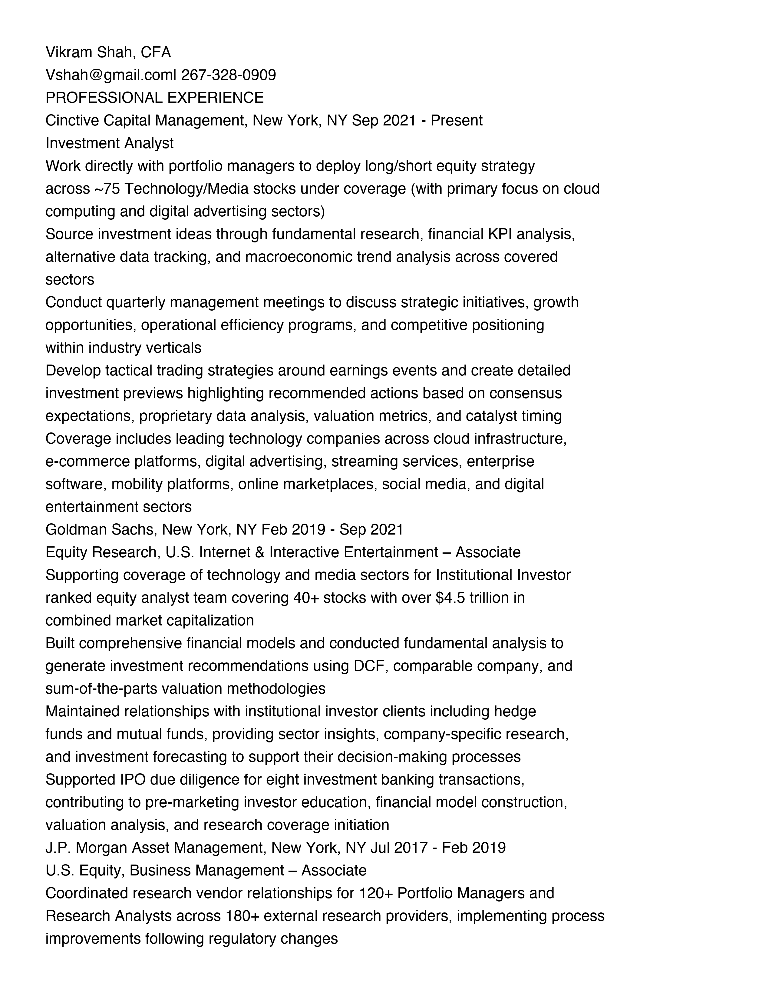


--- Page 2 of 2 ---



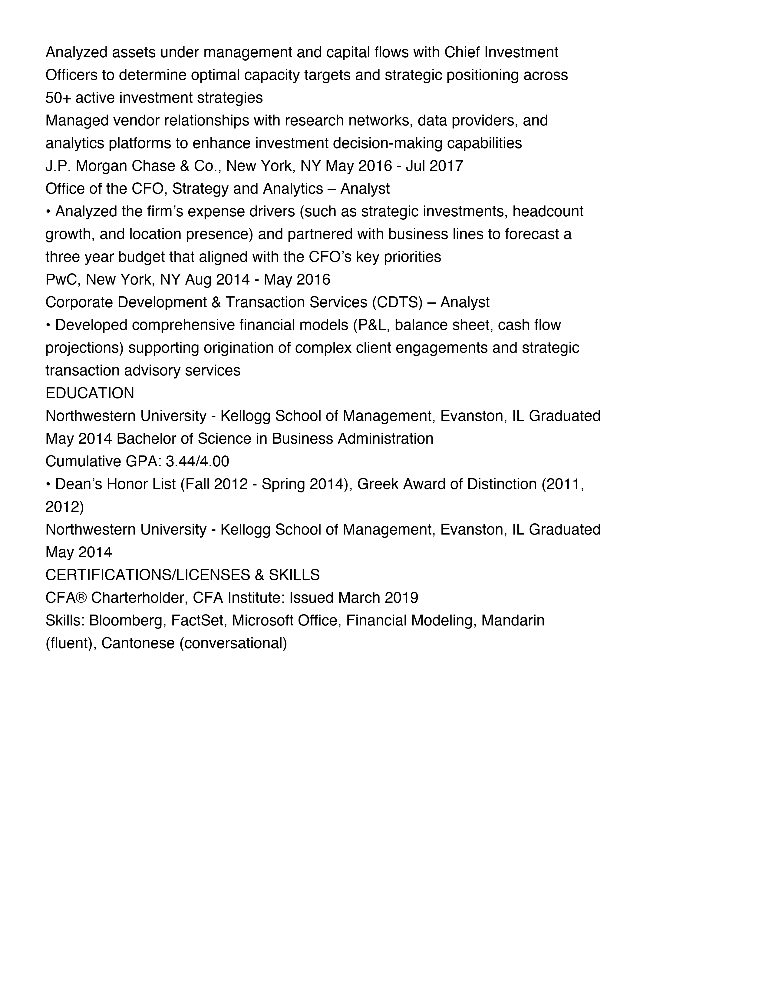




Displaying: Viktor Sharat.docx


--- Page 1 of 3 ---



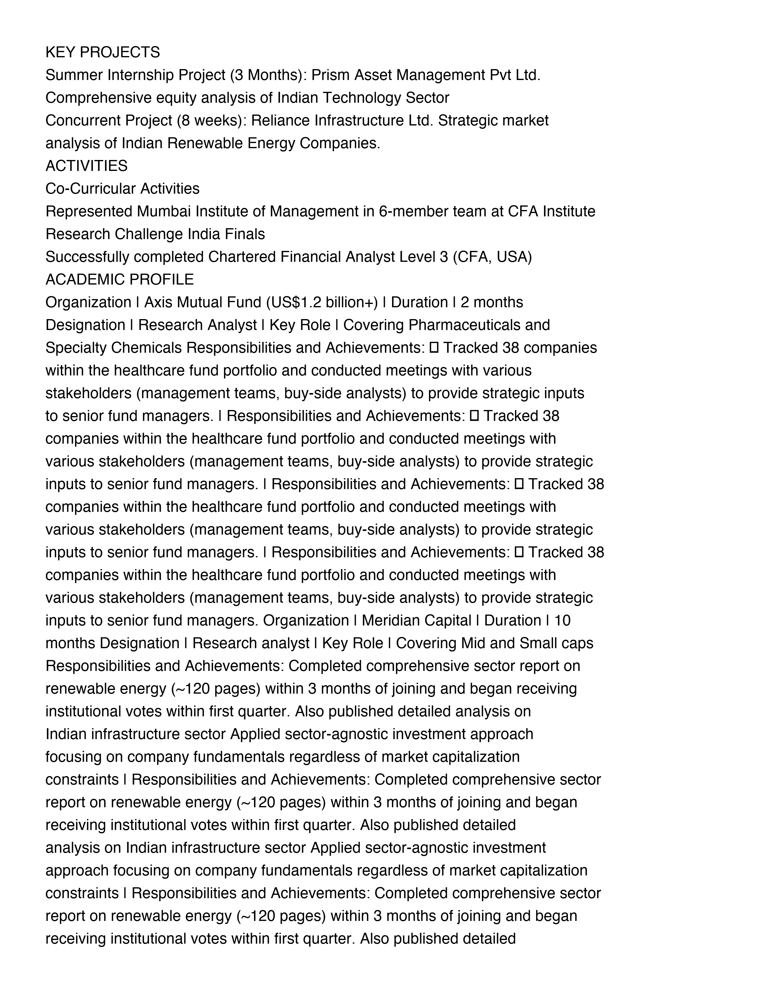


--- Page 2 of 3 ---



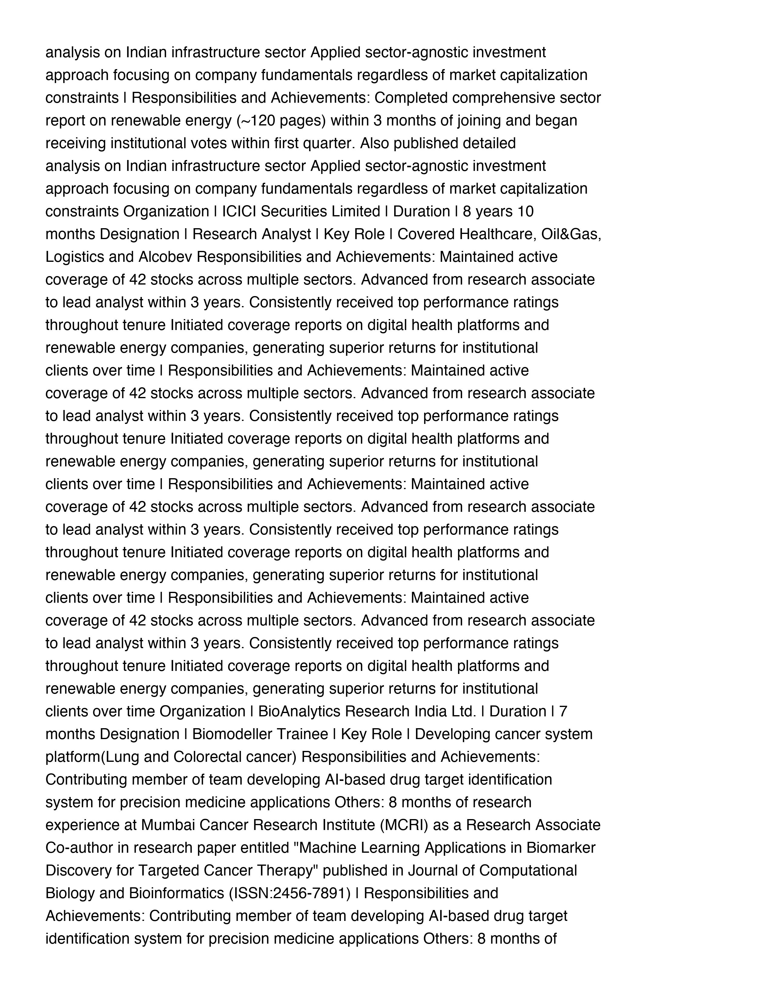


--- Page 3 of 3 ---



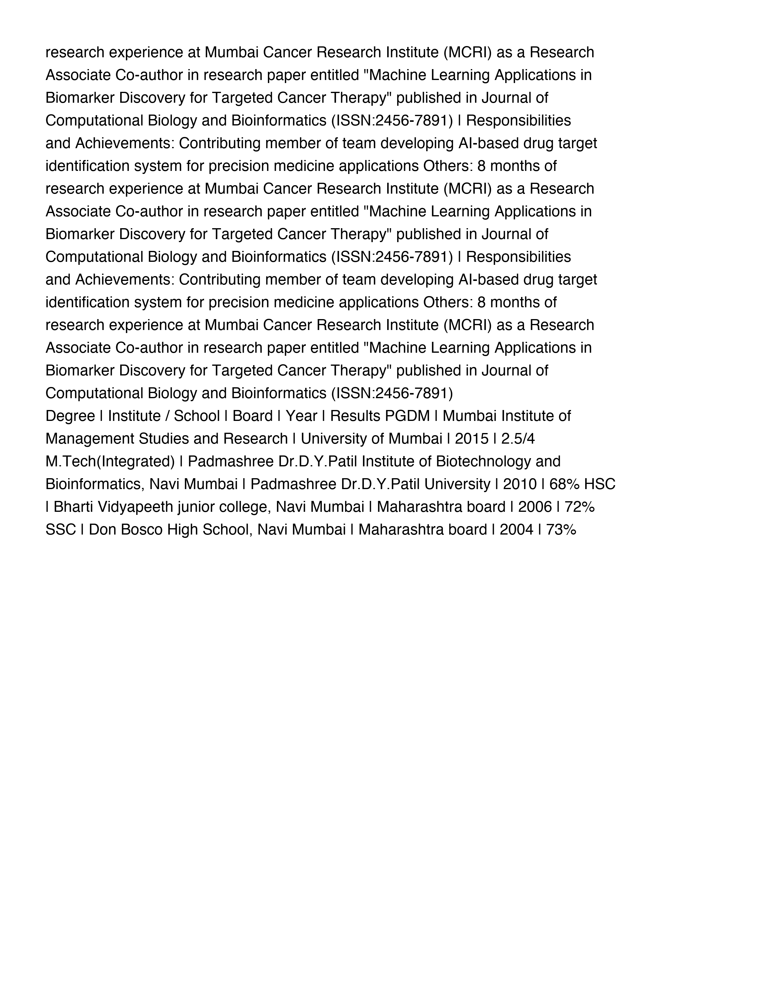




Displaying: Zara Al-Rashid.docx


--- Page 1 of 2 ---



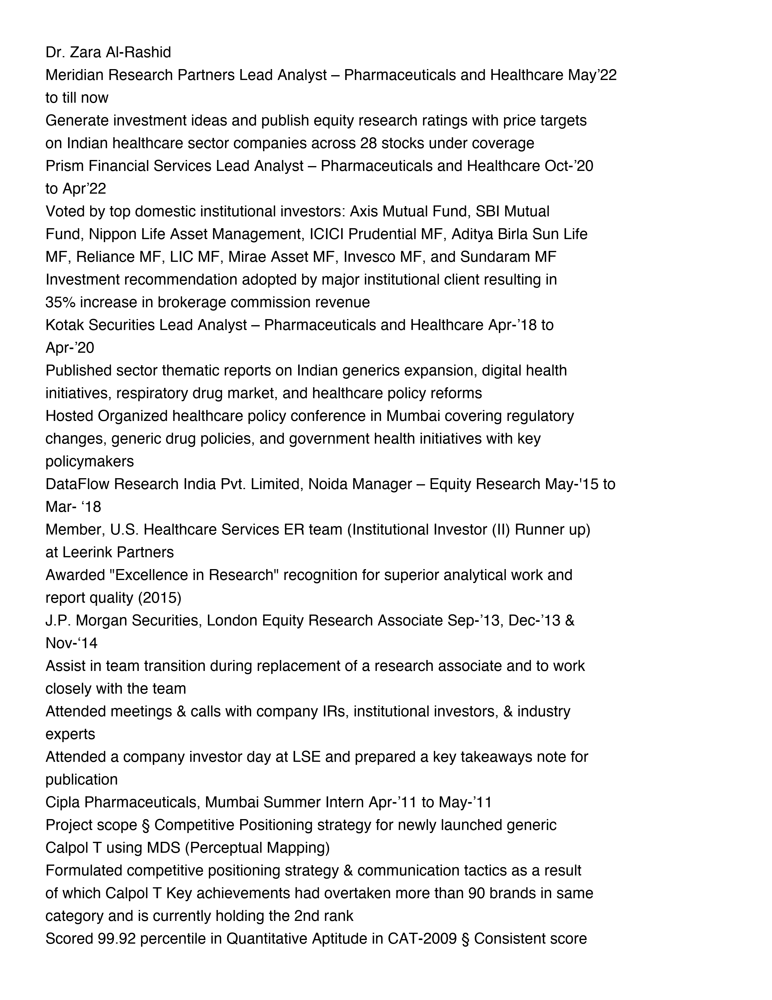


--- Page 2 of 2 ---



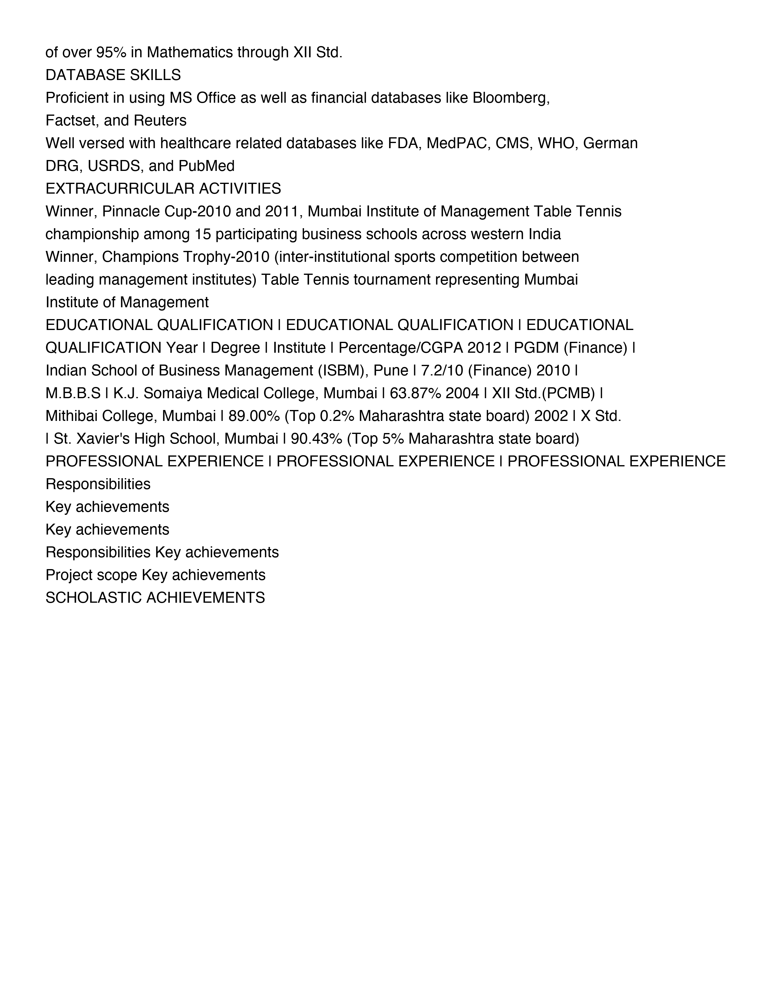

In [19]:

## 1. Document Visualization


def display_document(file_path: Path):
    """
    Display a single PDF/DOCX document as images in the notebook.
    
    Args:
        file_path: Path to the document file
    """
    file_path = Path(file_path)
    
    if not file_path.exists():
        print(f"File not found: {file_path}")
        return
    
    print(f"\n{'='*80}")
    print(f"Displaying: {file_path.name}")
    print(f"{'='*80}\n")
    
    try:
        # Initialize vision loader to convert document to images
        vision_loader = VisionDocumentLoader(config=config)
        
        # Convert document to images
        if file_path.suffix.lower() == '.pdf':
            images = vision_loader._pdf_to_images(file_path)
        elif file_path.suffix.lower() in ['.docx', '.doc']:
            images = vision_loader._docx_to_images(file_path)
        else:
            print(f"Unsupported file type: {file_path.suffix}")
            return
        
        # Display each page
        for page_num, image in enumerate(images):
            print(f"\n--- Page {page_num + 1} of {len(images)} ---\n")
            # Convert PIL Image to display format
            display(image)
            
    except Exception as e:
        print(f"Error displaying document: {e}")
        import traceback
        traceback.print_exc()


def display_directory(directory_path: Path):
    """
    Display all supported documents (PDFs and DOCX) in a directory.
    
    Args:
        directory_path: Path to the directory containing the documents.
    """
    directory = Path(directory_path)
    
    if not directory.exists() or not directory.is_dir():
        print(f"Directory not found: {directory_path}")
        return
    
    # Supported extensions
    supported = {".pdf", ".docx", ".doc"}
    
    # Get all matching files
    files = sorted([f for f in directory.iterdir()
                    if f.is_file() and f.suffix.lower() in supported])
    
    if not files:
        print("No supported documents found.")
        return
    
    print(f"\nFound {len(files)} document(s) to display:\n")
    
    # Display each document
    for f in files:
        display_document(f)
        print("\n" + "="*80 + "\n")


# Display all documents in the input folder
if input_folder.exists() and resume_files:
    display_directory(input_folder)
else:
    print("No resume files found to display.")

---

## 2. Document Validation

Validate each document to ensure it is actually a resume/CV before processing. This acts as a guardrail to prevent processing invalid documents.

In [20]:
# Initialize document validator
validator = DocumentValidator(config=config)

# Validate all documents
validation_results = []

print("Validating documents...\n")
print(f"{'File Name':<60} {'Is Resume':<12} {'Confidence':<12} {'Status':<10}")
print("-" * 80)

for file_path in resume_files:
    try:
        result = validator.validate_resume_preview(file_path)
        validation_results.append({
            'file_name': file_path.name,
            'file_path': str(file_path),
            'is_resume': result.is_resume,
            'confidence': result.confidence,
            'reason': result.reason,
            'document_type': result.document_type
        })
        
        # Display result
        status = "PASS" if result.is_resume else "✗ FAIL"
        print(f"{file_path.name:<40} {str(result.is_resume):<12} {result.confidence:.2f}        {status:<10}")
        
    except Exception as e:
        print(f"{file_path.name:<40} {'ERROR':<12} {'N/A':<12} {'ERROR':<10}")
        validation_results.append({
            'file_name': file_path.name,
            'file_path': str(file_path),
            'is_resume': False,
            'confidence': 0.0,
            'reason': f"Validation error: {str(e)}",
            'document_type': None
        })

print("\n" + "="*80)
print(f"Total files validated: {len(validation_results)}")
print(f"Valid resumes: {sum(1 for r in validation_results if r['is_resume'])}")
print(f"Invalid documents: {sum(1 for r in validation_results if not r['is_resume'])}")


# Display validation results as a DataFrame
validation_df = pd.DataFrame(validation_results)
print("\nValidation Results Table:")
display(validation_df)

# Filter valid resumes for processing
validated_files = [Path(r['file_path']) for r in validation_results if r['is_resume']]
print(f"\n {len(validated_files)} file(s) passed validation and will be processed")
print(f"✗ {len(resume_files) - len(validated_files)} file(s) failed validation and will be skipped")

Validating documents...

File Name                                                    Is Resume    Confidence   Status    
--------------------------------------------------------------------------------
Chen Li (Alex).docx                      True         0.90        PASS      
MARINA SILVA COSTA.docx                  True         0.95        PASS      
Marcus Chen-Rodriguez Resume.docx        True         0.95        PASS      
Michael Rodriguez, CFA.docx              True         0.90        PASS      
Omar El-Hassan 202405.pdf                True         0.95        PASS      
Priya Nakamura_sellside_healthcare_RLTM.docx True         0.90        PASS      
RYAN PATEL - Resume.pdf                  True         0.95        PASS      
Vikram Shah.docx                         True         0.90        PASS      
Viktor Sharat.docx                       True         0.90        PASS      
Zara Al-Rashid.docx                      True         0.95        PASS      

Total files validated

,file_name,file_path,is_resume,confidence,reason,document_type
0,Chen Li (Alex).docx,input/Chen Li (Alex).docx,True,0.90,"The document contains personal information, ed...",
1,MARINA SILVA COSTA.docx,input/MARINA SILVA COSTA.docx,True,0.95,"The document contains personal information, ed...",
2,Marcus Chen-Rodriguez Resume.docx,input/Marcus Chen-Rodriguez Resume.docx,True,0.95,"The document contains personal information, a ...",
3,"Michael Rodriguez, CFA.docx","input/Michael Rodriguez, CFA.docx",True,0.90,The document contains key elements typical of ...,
4,Omar El-Hassan 202405.pdf,input/Omar El-Hassan 202405.pdf,True,0.95,"The document contains personal information, wo...",None
5,Priya Nakamura_sellside_healthcare_RLTM.docx,input/Priya Nakamura_sellside_healthcare_RLTM....,True,0.90,"The document contains a profile overview, prof...",resume
6,RYAN PATEL - Resume.pdf,input/RYAN PATEL - Resume.pdf,True,0.95,"The document contains personal information, de...",
7,Vikram Shah.docx,input/Vikram Shah.docx,True,0.90,"The document contains personal information, pr...",
8,Viktor Sharat.docx,input/Viktor Sharat.docx,True,0.90,"The document contains key projects, activities...",
9,Zara Al-Rashid.docx,input/Zara Al-Rashid.docx,True,0.95,The document contains detailed work experience...,resume



 10 file(s) passed validation and will be processed
✗ 0 file(s) failed validation and will be skipped


---

## 3. Chunking Process

Load documents and split them into chunks for efficient processing.

In [21]:
# Initialize document loader and text splitter
vision_loader = VisionDocumentLoader(config=config)
text_splitter = TextSplitter(config=config)

# Process a sample document to demonstrate chunking
if validated_files:
    sample_file = validated_files[0]
    print(f"Processing sample document: {sample_file.name}\n")
    
    try:
        # Load document
        print("Step 1: Loading document with vision API...")
        documents = vision_loader.load_document(sample_file)
        print(f" Loaded {len(documents)} page(s)")
        
        # Display document statistics
        total_chars = sum(len(doc.page_content) for doc in documents)
        print(f"  Total characters extracted: {total_chars:,}")
        
        # Split into chunks
        print("\nStep 2: Splitting document into chunks...")
        chunks = text_splitter.split_documents(documents)
        print(f"  Created {len(chunks)} chunk(s)")
        
        # Display chunking statistics
        if chunks:
            chunk_sizes = [len(c.page_content) for c in chunks]
            avg_chunk_size = sum(chunk_sizes) / len(chunks)
            min_chunk_size = min(chunk_sizes)
            max_chunk_size = max(chunk_sizes)
            
            print(f"\nChunking Statistics:")
            print(f"  - Total chunks: {len(chunks)}")
            print(f"  - Average chunk size: {avg_chunk_size:.0f} characters")
            print(f"  - Min chunk size: {min_chunk_size} characters")
            print(f"  - Max chunk size: {max_chunk_size} characters")
            
            # Display sample chunks
            print(f"\nSample Chunks (showing first 3):")
            for i, chunk in enumerate(chunks[:3]):
                print(f"\n--- Chunk {i+1} ---")
                print(f"Size: {len(chunk.page_content)} characters")
                print(f"Metadata: {chunk.metadata}")
                print(f"Preview (first 200 chars):")
                print(chunk.page_content[:200] + "..." if len(chunk.page_content) > 200 else chunk.page_content)
        else:
            print("   No chunks created")
            
    except Exception as e:
        print(f"Error processing sample document: {e}")
        import traceback
        traceback.print_exc()
else:
    print("No validated files available for chunking demonstration.")

Processing sample document: Chen Li (Alex).docx

Step 1: Loading document with vision API...
 Loaded 2 page(s)
  Total characters extracted: 4,389

Step 2: Splitting document into chunks...
  Created 6 chunk(s)

Chunking Statistics:
  - Total chunks: 6
  - Average chunk size: 784 characters
  - Min chunk size: 489 characters
  - Max chunk size: 930 characters

Sample Chunks (showing first 3):

--- Chunk 1 ---
Size: 829 characters
Metadata: {'source': 'input/Chen Li (Alex).docx', 'file_name': 'Chen Li (Alex).docx', 'page': 0, 'total_pages': 2, 'extraction_method': 'vision'}
Preview (first 200 chars):
# Chen Li (Alex)

Mobile: +852 65478923  
Email: Alex_chen2024@gmail.com

# EDUCATION

## University of Hong Kong Hong Kong
Master of Science in Financial Technology Sept.2021 – Jul.2023  
Related Cou...

--- Chunk 2 ---
Size: 693 characters
Metadata: {'source': 'input/Chen Li (Alex).docx', 'file_name': 'Chen Li (Alex).docx', 'page': 0, 'total_pages': 2, 'extraction_method': 'vision'}
Previ

---

## 4. Resume Extraction

Extract structured data from all validated resumes using LLM-powered parsing. This is the core extraction step that converts unstructured resume text into structured JSON data.

In [22]:
# Initialize resume parser
parser = ResumeParser(config=config)

# Parse all validated resumes
parsed_resumes = []
failed_files = []

print("Starting resume extraction...\n")
print(f"{'File Name':<46} {'Status':<20} {'Name Extracted':<30}")
print("-" * 90)

for file_path in validated_files:
    try:
        print(f"{file_path.name:<40} {'Processing...':<20} {'':<30}", end='\r')
        parsed = parser.parse_resume(file_path)
        parsed_resumes.append(parsed)
        
        # Extract name for display
        name = parsed['structured_data'].name if parsed.get('structured_data') else 'Unknown'
        print(f"{file_path.name:<40} {'✓ SUCCESS':<20} {name:<30}")
        
    except Exception as e:
        failed_files.append((file_path.name, str(e)))
        print(f"{file_path.name:<40} {'✗ FAILED':<20} {'':<30}")
        print(f"  Error: {str(e)[:100]}")

print("\n" + "="*90)
print(f"\nExtraction Summary:")
print(f"  ✓ Successfully extracted: {len(parsed_resumes)} resume(s)")
print(f"  ✗ Failed: {len(failed_files)} resume(s)")

if failed_files:
    print(f"\nFailed files:")
    for file_name, error in failed_files:
        print(f"  - {file_name}: {error[:80]}")


# Display extraction statistics
if parsed_resumes:
    print("\n" + "="*90)
    print("Extraction Statistics:\n")
    
    stats = []
    for parsed in parsed_resumes:
        structured = parsed['structured_data']
        stats.append({
            'File Name': parsed['file_name'],
            'Name': structured.name,
            'Email': structured.email if structured.email else 'N/A',
            'Location': structured.location if structured.location else 'N/A',
            'Experience (years)': structured.experience_years if structured.experience_years else 0,
            'Work Positions': len(structured.work_experience),
            'Education Entries': len(structured.education),
            'Skills': len(structured.skills),
            'Certifications': len(structured.certifications),
            'Chunks': len(parsed.get('chunks', []))
        })
    
    stats_df = pd.DataFrame(stats)
    display(stats_df)
    
    # Display sample extracted data
    print("\n" + "="*90)
    print("Sample Extracted Data (First Resume):")
    print("="*90 + "\n")
    
    sample = parsed_resumes[0]
    structured = sample['structured_data']
    
    print(f"Name: {structured.name}")
    print(f"Email: {structured.email if structured.email else 'N/A'}")
    print(f"Phone: {structured.phone if structured.phone else 'N/A'}")
    print(f"Location: {structured.location if structured.location else 'N/A'}")
    print(f"Geography: {structured.geography.value}")
    print(f"Experience Years: {structured.experience_years if structured.experience_years else 'N/A'}")
    print(f"\nSummary:\n{structured.summary[:300] if structured.summary else 'N/A'}...")
    
    print(f"\nWork Experience ({len(structured.work_experience)} positions):")
    for i, exp in enumerate(structured.work_experience[:3], 1):  # Show first 3
        print(f"\n  {i}. {exp.position} at {exp.company}")
        print(f"     Period: {exp.start_date} - {exp.end_date or 'Present'}")
        if exp.description:
            print(f"     Description: {exp.description[:100]}...")
    
    print(f"\nEducation ({len(structured.education)} entries):")
    for i, edu in enumerate(structured.education[:3], 1):  # Show first 3
        print(f"\n  {i}. {edu.degree} in {edu.field}")
        print(f"     Institution: {edu.institution}")
        if edu.graduation_year:
            print(f"     Year: {edu.graduation_year}")
    
    print(f"\nSkills ({len(structured.skills)} total):")
    print(f"  {', '.join(structured.skills[:10])}...")
    
    print(f"\nProgramming Languages ({len(structured.programming_languages)}):")
    if structured.programming_languages:
        print(f"  {', '.join(structured.programming_languages)}")
    else:
        print("  None listed")
    
    print(f"\nCertifications ({len(structured.certifications)}):")
    for cert in structured.certifications[:3]:  # Show first 3
        print(f"  - {cert.name}" + (f" ({cert.issuer})" if cert.issuer else ""))
else:
    print("No resumes were successfully extracted.")

Starting resume extraction...

File Name                                      Status               Name Extracted                
------------------------------------------------------------------------------------------


extract_skills_certifications_additional: Field 'certifications' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'publications' is empty list - expected data may be missing


Chen Li (Alex).docx                      ✓ SUCCESS            Chen Li (Alex)                


extract_skills_certifications_additional: Field 'certifications' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'publications' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'awards' is empty list - expected data may be missing


MARINA SILVA COSTA.docx                  ✓ SUCCESS            Marina Silva Costa            


extract_skills_certifications_additional: Field 'programming_languages' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'tools' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'certifications' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'languages' is empty list - expected data may be missing


Marcus Chen-Rodriguez Resume.docx        ✓ SUCCESS            Marcus Chen-Rodriguez         


extract_work_education: Field 'work_experience' is not a list (got <class 'str'>)
extract_skills_certifications_additional: Field 'languages' is empty list - expected data may be missing


Michael Rodriguez, CFA.docx              ✓ SUCCESS            Michael Rodriguez, CFA        


extract_skills_certifications_additional: Field 'certifications' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'publications' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'awards' is empty list - expected data may be missing


Omar El-Hassan 202405.pdf                ✓ SUCCESS            Omar El-Hassan                


extract_skills_certifications_additional: Field 'programming_languages' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'tools' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'certifications' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'languages' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'publications' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'awards' is empty list - expected data may be missing


Priya Nakamura_sellside_healthcare_RLTM.docx ✓ SUCCESS            Priya Nakamura                


extract_work_education: Field 'work_experience' is not a list (got <class 'str'>)
extract_skills_certifications_additional: Field 'certifications' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'languages' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'publications' is empty list - expected data may be missing


RYAN PATEL - Resume.pdf                  ✓ SUCCESS            Ryan Patel                    


extract_skills_certifications_additional: Field 'programming_languages' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'publications' is empty list - expected data may be missing


Vikram Shah.docx                         ✓ SUCCESS            Vikram Shah                   


extract_skills_certifications_additional: Field 'programming_languages' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'tools' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'languages' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'awards' is empty list - expected data may be missing


Viktor Sharat.docx                       ✓ SUCCESS            <UNKNOWN>                     


extract_skills_certifications_additional: Field 'programming_languages' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'certifications' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'languages' is empty list - expected data may be missing
extract_skills_certifications_additional: Field 'publications' is empty list - expected data may be missing


Zara Al-Rashid.docx                      ✓ SUCCESS            Dr. Zara Al-Rashid            


Extraction Summary:
  ✓ Successfully extracted: 10 resume(s)
  ✗ Failed: 0 resume(s)

Extraction Statistics:



,File Name,Name,Email,Location,Experience (years),Work Positions,Education Entries,Skills,Certifications,Chunks
0,Chen Li (Alex).docx,Chen Li (Alex),Alex_chen2024@gmail.com,Hong Kong,4.0,6,2,43,0,6
1,MARINA SILVA COSTA.docx,Marina Silva Costa,marina.costa.finance@gmail.com,"London, United Kingdom",8.0,3,2,45,0,5
2,Marcus Chen-Rodriguez Resume.docx,Marcus Chen-Rodriguez,rchen@hotmail,"New York, NY",11.0,4,2,40,0,5
3,"Michael Rodriguez, CFA.docx","Michael Rodriguez, CFA",mrodriguez84@gmail.com,"Boston, MA",7.0,0,0,41,4,5
4,Omar El-Hassan 202405.pdf,Omar El-Hassan,o.elhassan15@gmail.com,"Paris, France",3.0,3,3,25,0,2
5,Priya Nakamura_sellside_healthcare_RLTM.docx,Priya Nakamura,N/A,N/A,9.0,6,5,34,0,8
6,RYAN PATEL - Resume.pdf,Ryan Patel,ryan.patel0403@gmail.com,"Brooklyn, NY 11201",7.0,0,0,40,0,8
7,Vikram Shah.docx,Vikram Shah,Vshah@gmail.com,"New York, NY",10.0,5,1,32,1,5
8,Viktor Sharat.docx,<UNKNOWN>,N/A,Mumbai,10.0,7,4,23,1,12
9,Zara Al-Rashid.docx,Dr. Zara Al-Rashid,N/A,Mumbai,13.0,6,4,25,0,5



Sample Extracted Data (First Resume):

Name: Chen Li (Alex)
Email: Alex_chen2024@gmail.com
Phone: +852 65478923
Location: Hong Kong
Geography: Asia-Pacific
Experience Years: 4.0

Summary:
Investment Analyst with quantitative finance expertise, specializing in Asian equity markets and financial technology. Experience includes developing multi-factor quantitative models for Greater China technology equities, conducting comprehensive market analysis, and implementing automated trading s...

Work Experience (6 positions):

  1. Investment Analyst at Bank of China Hong Kong
     Period: June 2021 - Sep 2023
     Description: Conduct comprehensive quantitative analysis on large-scale Asian equity datasets to provide statisti...

  2. Investment Intern at Bank of China Hong Kong
     Period: Dec 2019 - May 2021
     Description: Performed comprehensive research on Asian technology and healthcare sectors, covering 15+ sub-indust...

  3. Research Assistant (Economics Area) at Chinese Universi

---

## 5. Results Export

Export the parsed resume data to JSON and CSV formats for further analysis and use in the Streamlit application.

In [26]:
# Export parsed resumes to JSON and CSV
if parsed_resumes:
    # Get output paths from config
    parser_cfg = config.get_parser_config()
    output_json = parser_cfg.output_json
    output_csv = parser_cfg.output_csv
    
    # Ensure output directory exists
    json_path = Path(output_json)
    csv_path = Path(output_csv)
    json_path.parent.mkdir(parents=True, exist_ok=True)
    csv_path.parent.mkdir(parents=True, exist_ok=True)
    
    print(f"Exporting {len(parsed_resumes)} parsed resume(s)...\n")
    
    # Export to JSON
    try:
        export_to_json(parsed_resumes, output_json)
        print(f"JSON export successful: {output_json}")
        print(f"  File size: {json_path.stat().st_size / 1024:.2f} KB")
    except Exception as e:
        print(f"✗ JSON export failed: {e}")
    
    # Export to CSV
    try:
        csv_df = export_to_csv(parsed_resumes, output_csv)
        print(f"\nCSV export successful: {output_csv}")
        print(f"  File size: {csv_path.stat().st_size / 1024:.2f} KB")
        print(f"  Rows: {len(csv_df)}")
        print(f"  Columns: {len(csv_df.columns)}")
    except Exception as e:
        print(f"\n✗ CSV export failed: {e}")
    
    print(f"\n{'='*80}")
    print("Export Summary:")
    print(f"  - Total resumes exported: {len(parsed_resumes)}")
    print(f"  - JSON file: {output_json}")
    print(f"  - CSV file: {output_csv}")
    print(f"{'='*80}")
    
    # Display a preview of the exported CSV
    try:
        if csv_path.exists():
            print("\nCSV Preview (first 5 rows):\n")
            df_preview = pd.read_csv(csv_path)
            display(df_preview.head())
    except Exception as e:
        print(f"\nCould not display CSV preview: {e}")
else:
    print("No parsed resumes to export.")

Exporting 10 parsed resume(s)...

JSON export successful: parsed_resumes.json
  File size: 72.49 KB

CSV export successful: parsed_resumes.csv
  File size: 11.41 KB
  Rows: 10
  Columns: 13

Export Summary:
  - Total resumes exported: 10
  - JSON file: parsed_resumes.json
  - CSV file: parsed_resumes.csv

CSV Preview (first 5 rows):



,resume_uuid,file_name,name,email,location,geography,experience_years,sectors,skills,certifications,education,others,extraction_timestamp
0,resume-689d080da175,Chen Li (Alex).docx,Chen Li (Alex),Alex_chen2024@gmail.com,Hong Kong,Asia-Pacific,4.0,"Finance, Banking, Investment Management, Techn...","quantitative analysis, statistical analysis, d...",NaN,Master of Science Financial Technology; Bachel...,"{""volunteer_work"": ""Fujia Aid Teaching Society...",2026-01-22T15:47:07.547275
1,resume-080e35ea1668,MARINA SILVA COSTA.docx,Marina Silva Costa,marina.costa.finance@gmail.com,"London, United Kingdom",Europe,8.0,"Finance, Investment Management, Healthcare, Co...","Equity Research, Fundamental Research, Financi...",NaN,Master of business administration (MBA) ; BS E...,"{""professional_memberships"": ""Investment Manag...",2026-01-22T15:48:04.024107
2,resume-22e2f3acc173,Marcus Chen-Rodriguez Resume.docx,Marcus Chen-Rodriguez,rchen@hotmail,"New York, NY",US,11.0,"Healthcare, Finance, Investment Management, Li...","Financial modeling, Financial analysis, Health...",NaN,"Bachelor of Arts Economics, Secondary in Molec...","{""volunteer_work"": ""Big Brothers Big Sisters (...",2026-01-22T15:48:59.139644
3,resume-88867c031cba,"Michael Rodriguez, CFA.docx","Michael Rodriguez, CFA",mrodriguez84@gmail.com,"Boston, MA",US,7.0,"Asset Management, Finance, Investment Manageme...","Bloomberg Terminal, Excel, Advanced Financial ...","CFA Charterholder, Series 7, Series 63, Series 87",NaN,"{""professional_memberships"": ""Ross Investment ...",2026-01-22T15:49:59.073871
4,resume-fb7a6878af4d,Omar El-Hassan 202405.pdf,Omar El-Hassan,o.elhassan15@gmail.com,"Paris, France",Europe,3.0,"Finance, Investment Banking, Fixed Income, Der...","Quantitative Development, Derivatives Pricing,...",NaN,Diplôme d'Ingénieur Financial Engineering; Mas...,NaN,2026-01-22T15:50:35.123639


## To Run StreamLit App

To run the Streamlit application, execute the following command in your terminal:

```bash
streamlit run streamlit_app_langchain.py
```

The application will start on `http://localhost:8501` by default. You can access it in your web browser once it's running.

## Approach & Implementation Notes

### Initial Attempts with OCR-based Solutions

I initially explored structured output parsing using OCR-based approaches:

1. **Tesseract OCR**: 
   - Attempted to use Tesseract for text extraction and structured parsing
   - Found that Tesseract's one-shot approach was losing significant information, especially with complex resume layouts
   - Struggled with maintaining context and relationships between different sections

2. **PaddleOCR**:
   - Performed better than Tesseract in terms of accuracy
   - Still encountered challenges with information loss, particularly with:
     - Multi-column layouts
     - Complex formatting
     - Maintaining semantic relationships between sections

### Final Approach: Vision Language Models via API

Given the limitations of OCR-based approaches, I transitioned to using **Vision Language Models (VLMs) via API calls**. This approach provides:

- **Better accuracy**: VLMs can understand document structure and context more effectively
- **Improved information retention**: Better at preserving relationships between different resume sections
- **Structured output**: Can directly extract structured data while understanding the semantic meaning
- **Handles complex layouts**: More robust with various resume formats and layouts

The Vision Language Model approach allows for more reliable parsing of resume documents while maintaining the integrity of the extracted information.